#  Geospatial Data Analysis

In [ ]:
!pip install contextily
!pip install osmnx

In [ ]:
import numpy as np
import pandas as pd
import pyproj
import contextily as ctx
import geopandas as gpd
import shapely
import osmnx
import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
import matplotlib as mpl


In [ ]:
crs_gps = pyproj.CRS.from_epsg('4326')
crs_web = pyproj.CRS.from_epsg('3857')
map_source = ctx.providers.OpenStreetMap.Mapnik

In [ ]:
df_london = pd.read_csv('london_20k.csv')

In [ ]:
df_london.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 13 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   photo_id     20000 non-null  int64  
 1   owner        20000 non-null  object 
 2   gender       19986 non-null  float64
 3   occupation   9563 non-null   object 
 4   title        19585 non-null  object 
 5   description  10686 non-null  object 
 6   tags         15095 non-null  object 
 7   faves        20000 non-null  int64  
 8   lat          20000 non-null  float64
 9   lon          20000 non-null  float64
 10  u_city       11517 non-null  object 
 11  u_country    11680 non-null  object 
 12  taken        20000 non-null  object 
dtypes: float64(3), int64(2), object(8)
memory usage: 2.0+ MB


In [ ]:
df_london.head()

,photo_id,owner,gender,occupation,title,description,tags,faves,lat,lon,u_city,u_country,taken
0,12056545693,78191777@N00,1.0,Producer/DJ,près,<i>Let us draw near with a true heart in full ...,"clapham, london, england, ukgarage, dubstep, e...",0,51.465163,-0.129085,30307,USA,2014-01-20 15:19:44
1,12453639663,41087279@N00,1.0,Accountant,DSC_4241 Chyna Whyne from Jamaica Live at Char...,Chyna Whyne from Jamaica Live at Charlie Wrigh...,"chyna, whyne, from, jamaica, live, charlie, wr...",1,51.527672,-0.083648,London,England,2014-02-09 23:05:35
2,13185773995,41087279@N00,1.0,Accountant,DSC_6178 Flirt 69 Birthday Party at Charlie Wr...,Flirt 69 Birthday Party at Charlie Wrights Mus...,"flirt, 69, birthday, party, charlie, wrights, ...",0,51.527672,-0.083648,London,England,2014-03-14 22:24:02
3,13295046445,30625665@N00,1.0,NaN,Bank Limited,BREAKING NEWS My 806th picture to be viewed ov...,"bank, ex, cash, point, atm, brick, stone, lond...",5,51.513042,-0.089221,NaN,NaN,2014-03-20 09:13:03
4,13357656115,41087279@N00,1.0,Accountant,DSC_6743 Ray Estaire Live at Charlie Wrights M...,Ray Estaire Live at Charlie Wrights Music Loun...,"ray, estaire, jazz, ensemble, the, dominant, 7...",1,51.527672,-0.083648,London,England,2014-03-21 23:18:39


In [ ]:
df_london['taken_date'] = pd.to_datetime(df_london['taken'], format='%Y-%m-%d %H:%M:%S', errors='coerce')
df_london.drop('taken', axis=1, inplace=True)

In [ ]:
gdf_london_points = gpd.GeoDataFrame(df_london.assign(geometry=df_london[['lon', 'lat']].apply(lambda x: shapely.Point(tuple(x)), axis=1)),crs=crs_gps)

gdf_london_points.head()

,photo_id,owner,gender,occupation,title,description,tags,faves,lat,lon,u_city,u_country,taken_date,geometry
0,12056545693,78191777@N00,1.0,Producer/DJ,près,<i>Let us draw near with a true heart in full ...,"clapham, london, england, ukgarage, dubstep, e...",0,51.465163,-0.129085,30307,USA,2014-01-20 15:19:44,POINT (-0.12909 51.46516)
1,12453639663,41087279@N00,1.0,Accountant,DSC_4241 Chyna Whyne from Jamaica Live at Char...,Chyna Whyne from Jamaica Live at Charlie Wrigh...,"chyna, whyne, from, jamaica, live, charlie, wr...",1,51.527672,-0.083648,London,England,2014-02-09 23:05:35,POINT (-0.08365 51.52767)
2,13185773995,41087279@N00,1.0,Accountant,DSC_6178 Flirt 69 Birthday Party at Charlie Wr...,Flirt 69 Birthday Party at Charlie Wrights Mus...,"flirt, 69, birthday, party, charlie, wrights, ...",0,51.527672,-0.083648,London,England,2014-03-14 22:24:02,POINT (-0.08365 51.52767)
3,13295046445,30625665@N00,1.0,NaN,Bank Limited,BREAKING NEWS My 806th picture to be viewed ov...,"bank, ex, cash, point, atm, brick, stone, lond...",5,51.513042,-0.089221,NaN,NaN,2014-03-20 09:13:03,POINT (-0.08922 51.51304)
4,13357656115,41087279@N00,1.0,Accountant,DSC_6743 Ray Estaire Live at Charlie Wrights M...,Ray Estaire Live at Charlie Wrights Music Loun...,"ray, estaire, jazz, ensemble, the, dominant, 7...",1,51.527672,-0.083648,London,England,2014-03-21 23:18:39,POINT (-0.08365 51.52767)


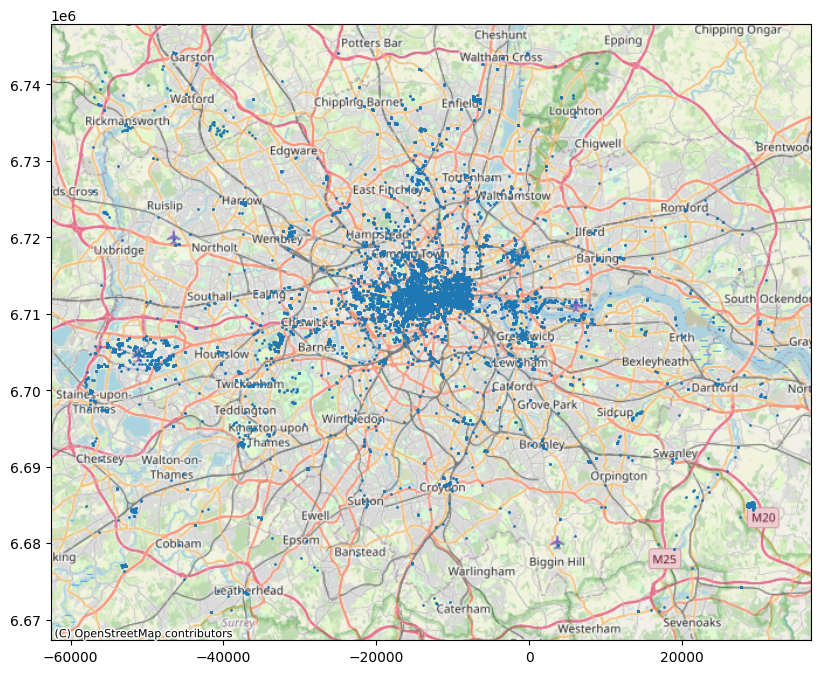

In [ ]:
ax = gdf_london_points.to_crs(crs_web).sort_values('faves').plot( markersize=1, legend=True, figsize=(16,8))

ctx.add_basemap(ax=ax, crs=crs_web, source=map_source)

## Time analysis

Text(0.5, 1.0, 'Number of Photos by Year')

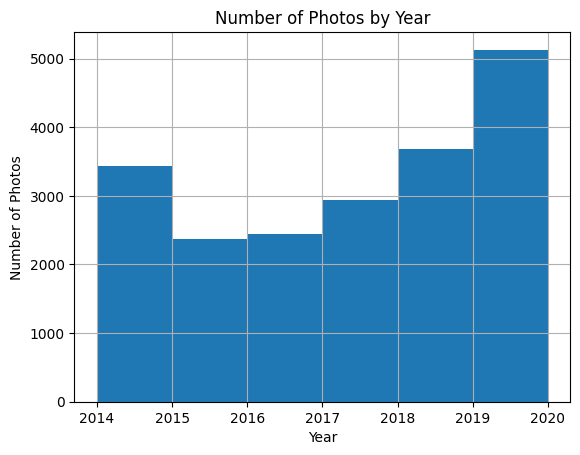

In [ ]:
ax = gdf_london_points.taken_date.round('D').transform(lambda date: date.year).to_frame().hist('taken_date', bins=list(range(2014, 2021)))

ax[0][0].set_xlabel('Year')
ax[0][0].set_ylabel('Number of Photos')
ax[0][0].set_title('Number of Photos by Year')

Text(0.5, 1.0, 'Number of Photos by Month')

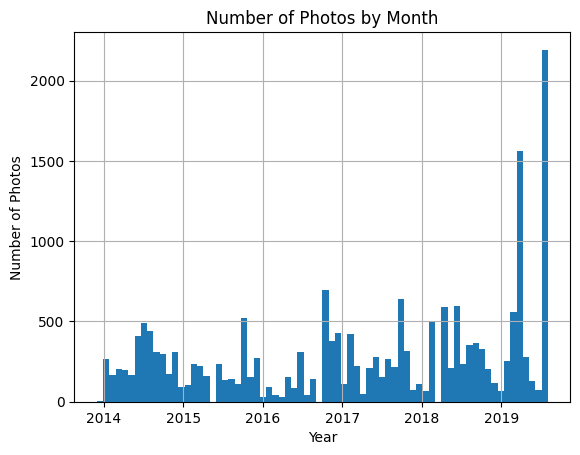

In [ ]:
ax = gdf_london_points.taken_date.round('D').transform(lambda date: date + pd.offsets.MonthBegin(-1)).sort_values().to_frame().hist('taken_date', bins=(2019-2014+1)*12)

ax[0][0].set_xlabel('Year')
ax[0][0].set_ylabel('Number of Photos')
ax[0][0].set_title('Number of Photos by Month')

## London's boroughs

In [ ]:
gdf_london_area = osmnx.features_from_place('London',tags={'name': 'London','type': 'boundary', 'boundary': 'administrative','admin_level': '8'})

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/matplotlib/text.py:753: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  posx = float(self.convert_xunits(self._x))
/usr/local/lib/python3.10/dist-packages/matplotlib/text.py:754: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  posy = float(self.convert_yu

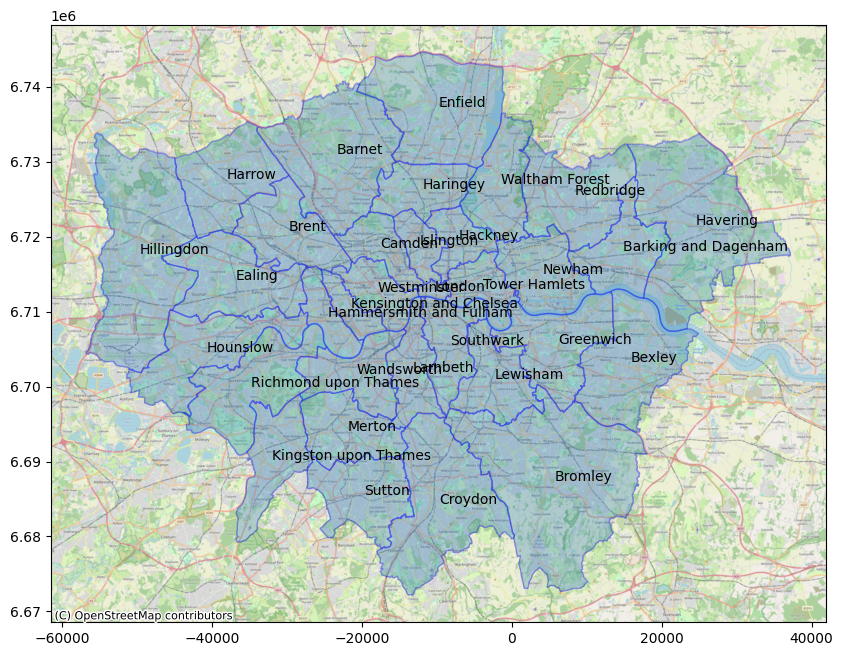

In [ ]:
gdf_london_areas = gdf_london_area.reset_index().set_index(['element_type','place','osmid']).loc['relation'].to_crs(crs=crs_web)

gdf_filtered_borough = gdf_london_areas[(gdf_london_areas['name'].fillna('').str.contains('Borough of'))]
gdf_filtered_city = gdf_london_areas[(gdf_london_areas['name'].fillna('').str.contains('City of'))]
gdf_filtered_city = gdf_filtered_city.dropna(subset=['admin_level'])

gdf_areas_combined = gpd.GeoDataFrame(pd.concat([gdf_filtered_city, gdf_filtered_borough], ignore_index=True))
gdf_areas_combined['name'] = gdf_areas_combined['name'].str.replace(r'^.*?Borough of ', '', regex=True)
gdf_areas_combined['name'] = gdf_areas_combined['name'].str.replace(r'^.*?City of ', '', regex=True)


ax = gdf_areas_combined.plot(edgecolor='blue', alpha=.3, figsize=(10, 10))

for rel in gdf_areas_combined.index:
    lon,lat = np.asarray(gdf_areas_combined.centroid.loc[rel].xy)
    ax.text(x=lon,y=lat,s=gdf_areas_combined.loc[rel]['name'])

ctx.add_basemap(ax=ax, source=map_source, zoom=12)

## Location Density Analysis

In [ ]:
gdf_london_points=gdf_london_points.to_crs(crs=crs_web)
gdf_areas_combined=gdf_areas_combined.to_crs(crs=crs_web)

points_in_areas = gpd.sjoin(gdf_london_points, gdf_areas_combined, how="inner", predicate="within")
point_counts = points_in_areas.groupby('index_right').size()
gdf_areas_combined['point_count'] = gdf_areas_combined.index.map(point_counts).fillna(0)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<Axes: title={'center': 'Density per borough'}, xlabel='name'>

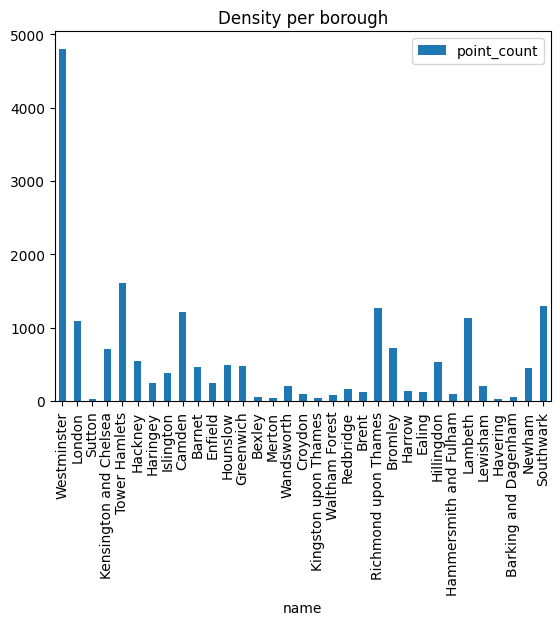

In [ ]:
gdf_areas_combined.plot(column='point_count', kind='bar', x='name', y='point_count', title='Density per borough')

/usr/local/lib/python3.10/dist-packages/matplotlib/text.py:753: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  posx = float(self.convert_xunits(self._x))
/usr/local/lib/python3.10/dist-packages/matplotlib/text.py:754: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  posy = float(self.convert_yunits(self._y))
/usr/local/lib/python3.10/dist-packages/matplotlib/text.py:894: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  x = float(self.convert_xunits(self._x))
/usr/local/li

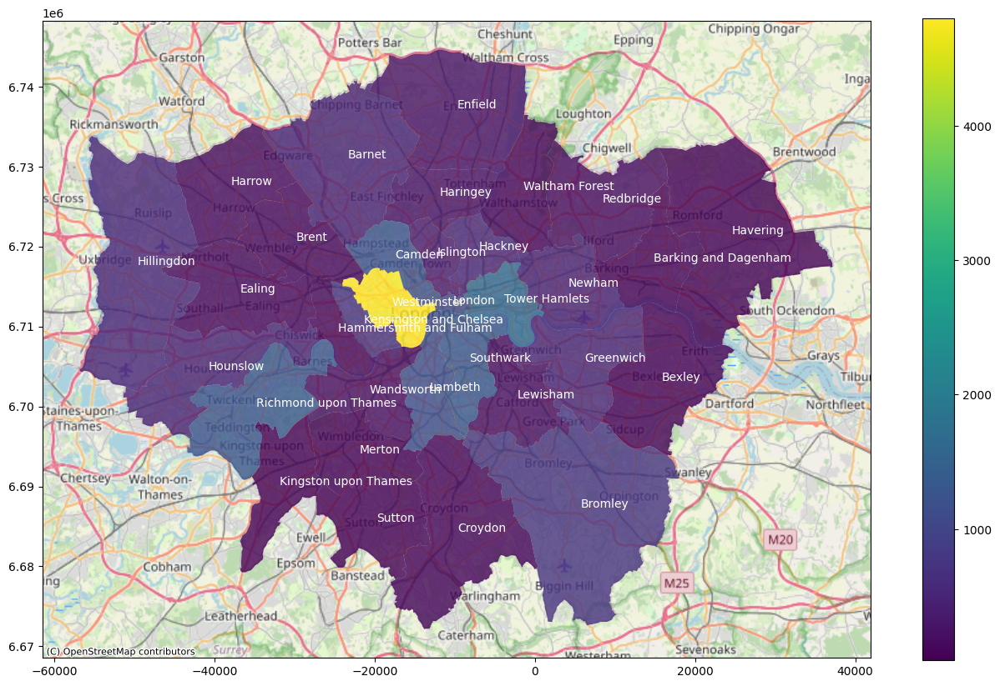

In [ ]:
ax = gdf_areas_combined.to_crs(crs_web).plot(column='point_count', alpha=0.8, legend=True, figsize=(16,10))

for rel in gdf_areas_combined.index:
    lon,lat = np.asarray(gdf_areas_combined.centroid.loc[rel].xy)
    ax.text(x=lon,y=lat,s=gdf_areas_combined.loc[rel]['name'], color='white')

ctx.add_basemap(ax=ax, crs=crs_web, source=map_source)

## Origin destination matrix grouped by user



In [ ]:
print(gdf_london_points.owner.unique().size)

1396


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
gdf_london_points.taken_date.isna().sum()

0

In [ ]:
gdf_london_points=gdf_london_points.to_crs(crs=crs_web)
gdf_areas_combined=gdf_areas_combined.to_crs(crs=crs_web)

points_with_areas = gpd.sjoin(gdf_london_points, gdf_areas_combined, how="left", predicate="within")

points_with_areas = points_with_areas[['geometry', 'name']]
points_with_areas.rename(columns={'name': 'area_name'}, inplace=True)

merged_gdf = points_with_areas.join(gdf_london_points, lsuffix='_point', rsuffix='_polygon', how='outer')


In [ ]:
merged_gdf.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,geometry_point,area_name,photo_id,owner,gender,occupation,title,description,tags,faves,lat,lon,u_city,u_country,taken_date,geometry_polygon
0,POINT (-14369.676 6703991.831),Lambeth,12056545693,78191777@N00,1.0,Producer/DJ,près,<i>Let us draw near with a true heart in full ...,"clapham, london, england, ukgarage, dubstep, e...",0,51.465163,-0.129085,30307,USA,2014-01-20 15:19:44,POINT (-14369.676 6703991.831)
1,POINT (-9311.653 6715168.957),Hackney,12453639663,41087279@N00,1.0,Accountant,DSC_4241 Chyna Whyne from Jamaica Live at Char...,Chyna Whyne from Jamaica Live at Charlie Wrigh...,"chyna, whyne, from, jamaica, live, charlie, wr...",1,51.527672,-0.083648,London,England,2014-02-09 23:05:35,POINT (-9311.653 6715168.957)
2,POINT (-9311.653 6715168.957),Hackney,13185773995,41087279@N00,1.0,Accountant,DSC_6178 Flirt 69 Birthday Party at Charlie Wr...,Flirt 69 Birthday Party at Charlie Wrights Mus...,"flirt, 69, birthday, party, charlie, wrights, ...",0,51.527672,-0.083648,London,England,2014-03-14 22:24:02,POINT (-9311.653 6715168.957)
3,POINT (-9932.036 6712551.617),London,13295046445,30625665@N00,1.0,NaN,Bank Limited,BREAKING NEWS My 806th picture to be viewed ov...,"bank, ex, cash, point, atm, brick, stone, lond...",5,51.513042,-0.089221,NaN,NaN,2014-03-20 09:13:03,POINT (-9932.036 6712551.617)
4,POINT (-9311.653 6715168.957),Hackney,13357656115,41087279@N00,1.0,Accountant,DSC_6743 Ray Estaire Live at Charlie Wrights M...,Ray Estaire Live at Charlie Wrights Music Loun...,"ray, estaire, jazz, ensemble, the, dominant, 7...",1,51.527672,-0.083648,London,England,2014-03-21 23:18:39,POINT (-9311.653 6715168.957)


In [ ]:
unique_origins = merged_gdf.area_name.unique()
unique_origins =unique_origins[~pd.isnull(unique_origins)]
origin_to_index = {value: idx for idx, value in enumerate(unique_origins)}

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
od_matrix = np.zeros((len(unique_origins), len(unique_origins)), dtype=np.int32)

od_matrix

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int32)

In [ ]:
for user in merged_gdf.owner.unique():
    traversed_clusters = \
        merged_gdf\
            .loc[merged_gdf.owner==user]\
            .sort_values('taken_date')\
            .area_name\
            .values

    if traversed_clusters.shape[0] < 2:
        continue

    def map_string_to_int(s):
      return origin_to_index.get(s, -1)

    vectorized_map = np.vectorize(map_string_to_int)
    traversed_clusters_id = vectorized_map(traversed_clusters)

    # get O-D cluster id pairs
    od_traces = \
        pd.DataFrame(
            np.vstack(
                [traversed_clusters_id[:-1],
                 traversed_clusters_id[1:],
                 np.ones(traversed_clusters_id[:-1].shape[0])]
            ).astype(np.int32).T,
            columns=['o', 'd', 'c']
        ).groupby(['o', 'd']).agg('sum').reset_index()

    od_matrix[od_traces.loc[:, 'o'], od_traces.loc[:, 'd']] += od_traces.loc[:, 'c']

print(od_matrix)

[[880   0  13 ...   2   0   1]
 [  1 434   9 ...   0   0   0]
 [ 17  11 715 ...   0   1   0]
 ...
 [  3   0   0 ...  21   0   0]
 [  0   0   1 ...   0  39   3]
 [  3   1   3 ...   0   2 869]]


In [ ]:
num_areas = merged_gdf.size
valid_pairs = np.argwhere(od_matrix)

df_od_matrix = pd.DataFrame({
    'o': valid_pairs[:, 0],
    'd': valid_pairs[:, 1],
    'c': od_matrix[valid_pairs[:, 0], valid_pairs[:, 1]]
})



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:

gdf_seperated = gdf_areas_combined[['name', 'geometry']]
gdf_seperated = gdf_seperated.drop_duplicates(subset=['name'])

gdf_seperated['centroid'] = gdf_seperated.geometry.centroid

gdf_seperated['category_mapped'] = gdf_seperated['name'].map(origin_to_index)

merged_df2 = pd.merge(df_od_matrix, gdf_seperated[['category_mapped', 'centroid']],
                     left_on='o', right_on='category_mapped', how='left')
merged_df2.rename(columns={'centroid': 'centroid_o'}, inplace=True)

merged_df3 = pd.merge(merged_df2, gdf_seperated[['category_mapped', 'centroid']],
                     left_on='d', right_on='category_mapped', how='left')
merged_df3.rename(columns={'centroid': 'centroid_d'}, inplace=True)

merged_df3.drop(['category_mapped_x', 'category_mapped_y'], axis=1, inplace=True)
merged_df3

,o,d,c,centroid_o,centroid_d
0,0,0,880,POINT (-13171.222 6701972.059),POINT (-13171.222 6701972.059)
1,0,2,13,POINT (-13171.222 6701972.059),POINT (-10291.533 6712796.143)
2,0,3,6,POINT (-13171.222 6701972.059),POINT (-21398.439 6710436.127)
3,0,4,34,POINT (-13171.222 6701972.059),POINT (-8244.418 6705615.142)
4,0,5,25,POINT (-13171.222 6701972.059),POINT (-17524.637 6718520.201)
...,...,...,...,...,...
516,32,24,1,POINT (8445.241 6725552.923),POINT (-2259.101 6700977.514)
517,32,27,1,POINT (8445.241 6725552.923),POINT (-37989.590 6727714.849)
518,32,28,1,POINT (8445.241 6725552.923),POINT (-19767.046 6685595.894)
519,32,31,2,POINT (8445.241 6725552.923),POINT (14823.157 6718083.376)


In [ ]:
merged_df3['geometry'] = \
    merged_df3[['centroid_o', 'centroid_d']].apply(lambda x: shapely.LineString(x), axis=1)

merged_df3

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,o,d,c,centroid_o,centroid_d,geometry
0,0,0,880,POINT (-13171.222 6701972.059),POINT (-13171.222 6701972.059),LINESTRING (-13171.222097774535 6701972.058848...
1,0,2,13,POINT (-13171.222 6701972.059),POINT (-10291.533 6712796.143),LINESTRING (-13171.222097774535 6701972.058848...
2,0,3,6,POINT (-13171.222 6701972.059),POINT (-21398.439 6710436.127),LINESTRING (-13171.222097774535 6701972.058848...
3,0,4,34,POINT (-13171.222 6701972.059),POINT (-8244.418 6705615.142),LINESTRING (-13171.222097774535 6701972.058848...
4,0,5,25,POINT (-13171.222 6701972.059),POINT (-17524.637 6718520.201),LINESTRING (-13171.222097774535 6701972.058848...
...,...,...,...,...,...,...
516,32,24,1,POINT (8445.241 6725552.923),POINT (-2259.101 6700977.514),LINESTRING (8445.241091865822 6725552.92293816...
517,32,27,1,POINT (8445.241 6725552.923),POINT (-37989.590 6727714.849),LINESTRING (8445.241091865822 6725552.92293816...
518,32,28,1,POINT (8445.241 6725552.923),POINT (-19767.046 6685595.894),LINESTRING (8445.241091865822 6725552.92293816...
519,32,31,2,POINT (8445.241 6725552.923),POINT (14823.157 6718083.376),LINESTRING (8445.241091865822 6725552.92293816...


In [ ]:
gdf_od_m = gpd.GeoDataFrame(merged_df3[['o', 'd', 'c', 'geometry']],geometry='geometry',crs=crs_web)
gdf_od_m

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,o,d,c,geometry
0,0,0,880,"LINESTRING (-13171.222 6701972.059, -13171.222..."
1,0,2,13,"LINESTRING (-13171.222 6701972.059, -10291.533..."
2,0,3,6,"LINESTRING (-13171.222 6701972.059, -21398.439..."
3,0,4,34,"LINESTRING (-13171.222 6701972.059, -8244.418 ..."
4,0,5,25,"LINESTRING (-13171.222 6701972.059, -17524.637..."
...,...,...,...,...
516,32,24,1,"LINESTRING (8445.241 6725552.923, -2259.101 67..."
517,32,27,1,"LINESTRING (8445.241 6725552.923, -37989.590 6..."
518,32,28,1,"LINESTRING (8445.241 6725552.923, -19767.046 6..."
519,32,31,2,"LINESTRING (8445.241 6725552.923, 14823.157 67..."


In [ ]:
gdf_od_m['od'] = gdf_od_m[['o', 'd']].apply(lambda x: tuple(x.sort_values().values), axis=1)

gdf_od_combination = gdf_od_m.groupby('od').agg({'geometry': lambda x: list(x)[0]}).join(gdf_od_m.groupby('od').agg({'c': 'sum'})).set_geometry('geometry')

gdf_od_combination

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,geometry,c
od,,
"(0, 0)","LINESTRING (-13171.222 6701972.059, -13171.222...",880
"(0, 1)","LINESTRING (-7048.184 6719572.193, -13171.222 ...",1
"(0, 2)","LINESTRING (-13171.222 6701972.059, -10291.533...",30
"(0, 3)","LINESTRING (-13171.222 6701972.059, -21398.439...",11
"(0, 4)","LINESTRING (-13171.222 6701972.059, -8244.418 ...",54
...,...,...
"(29, 32)","LINESTRING (-31935.151 6690204.604, 8445.241 6...",2
"(30, 30)","LINESTRING (-21957.696 6694133.180, -21957.696...",21
"(31, 31)","LINESTRING (14823.157 6718083.376, 14823.157 6...",39


In [ ]:
gdf_od_m_ = gdf_od_combination.loc[list(map(lambda od: od[0]!=od[1], gdf_od_combination.index.values))].copy()
gdf_od_m_['linewidth'] = gdf_od_m_.c
gdf_od_m_

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,geometry,c,linewidth
od,,,
"(0, 1)","LINESTRING (-7048.184 6719572.193, -13171.222 ...",1,1
"(0, 2)","LINESTRING (-13171.222 6701972.059, -10291.533...",30,30
"(0, 3)","LINESTRING (-13171.222 6701972.059, -21398.439...",11,11
"(0, 4)","LINESTRING (-13171.222 6701972.059, -8244.418 ...",54,54
"(0, 5)","LINESTRING (-13171.222 6701972.059, -17524.637...",46,46
...,...,...,...
"(27, 32)","LINESTRING (8445.241 6725552.923, -37989.590 6...",1,1
"(28, 29)","LINESTRING (-19767.046 6685595.894, -31935.151...",1,1
"(28, 32)","LINESTRING (-19767.046 6685595.894, 8445.241 6...",2,2


In [ ]:
gdf_seperated['markersize'] = np.clip(od_matrix[np.arange(len(gdf_seperated)), np.arange(len(gdf_seperated))] * 5, a_min=100, a_max=1000)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


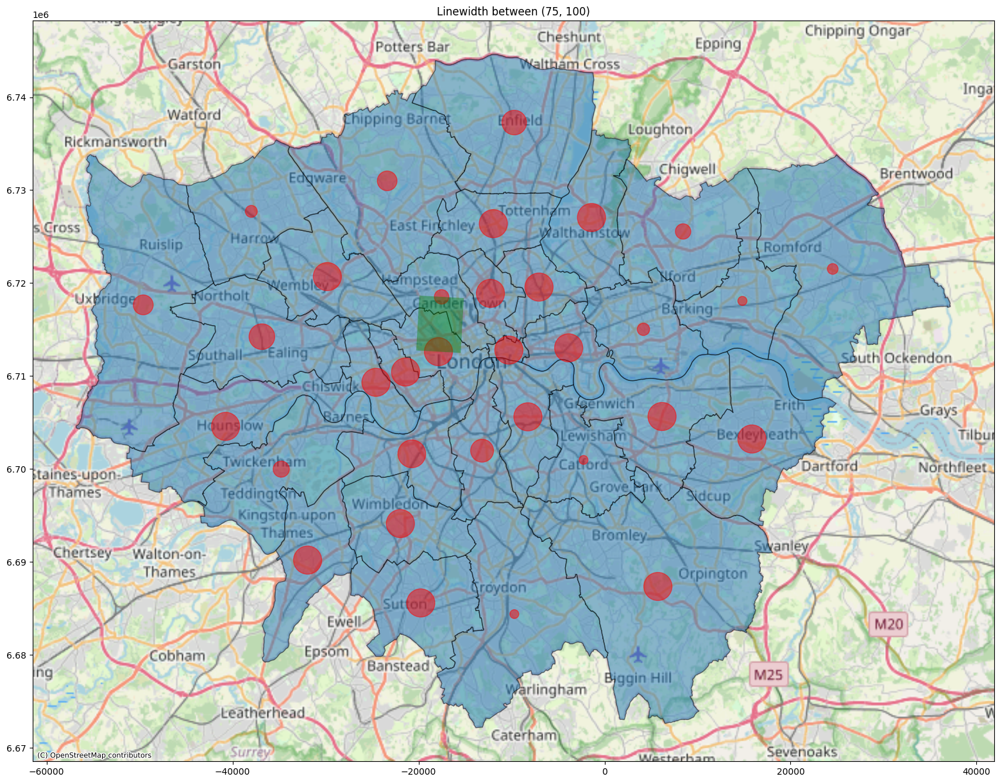

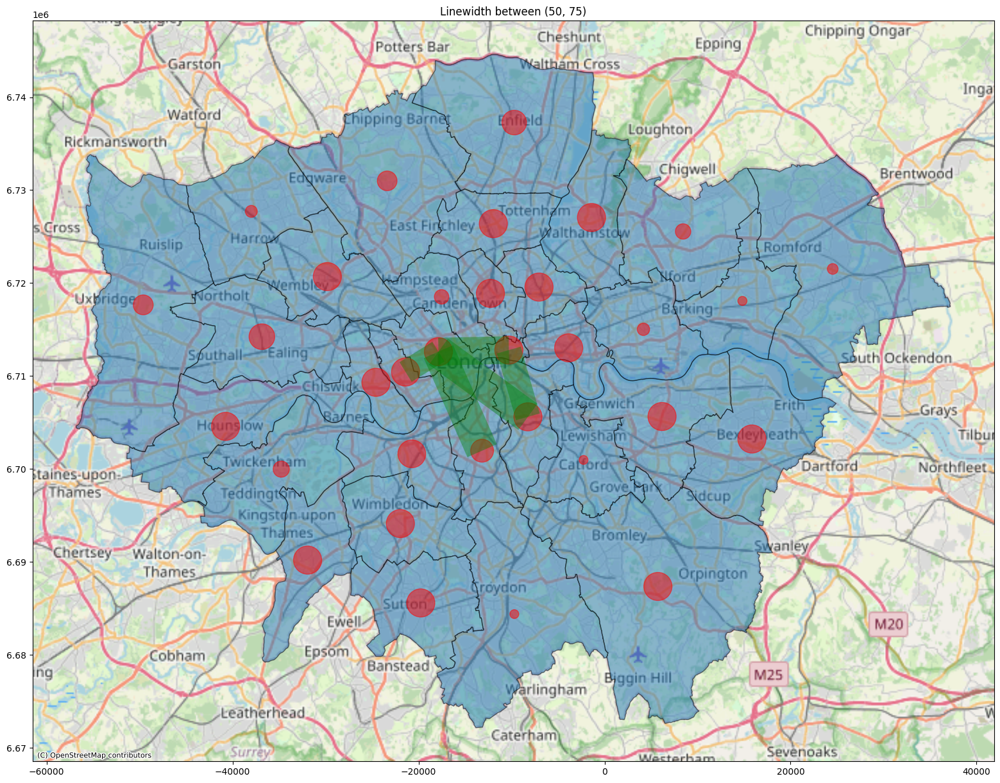

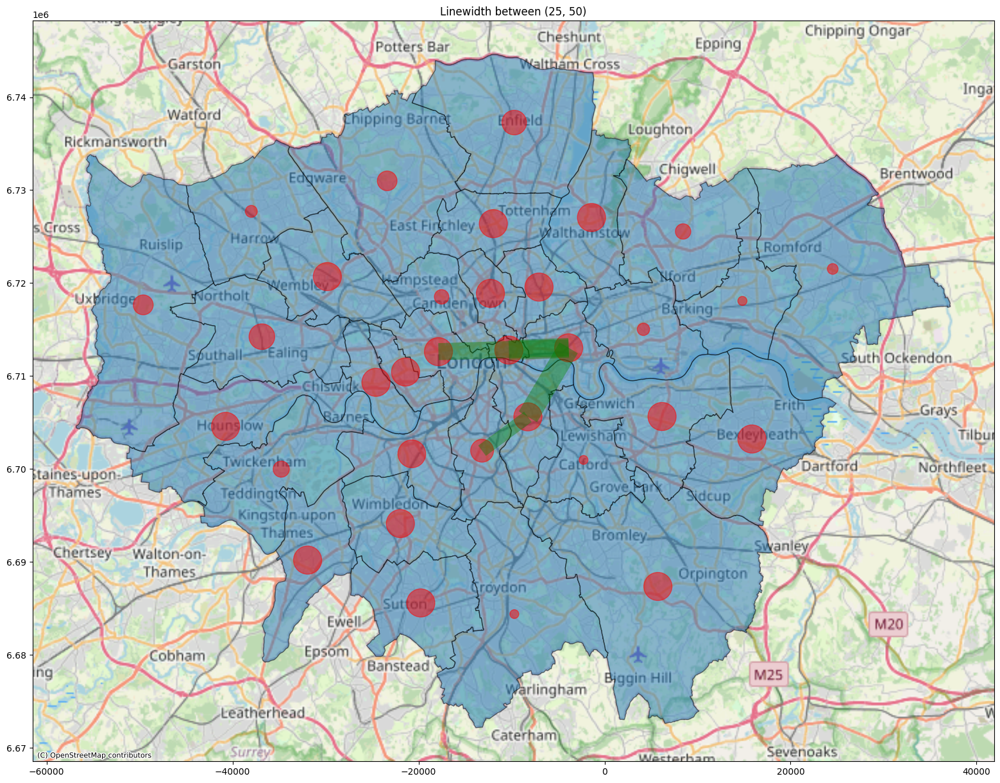

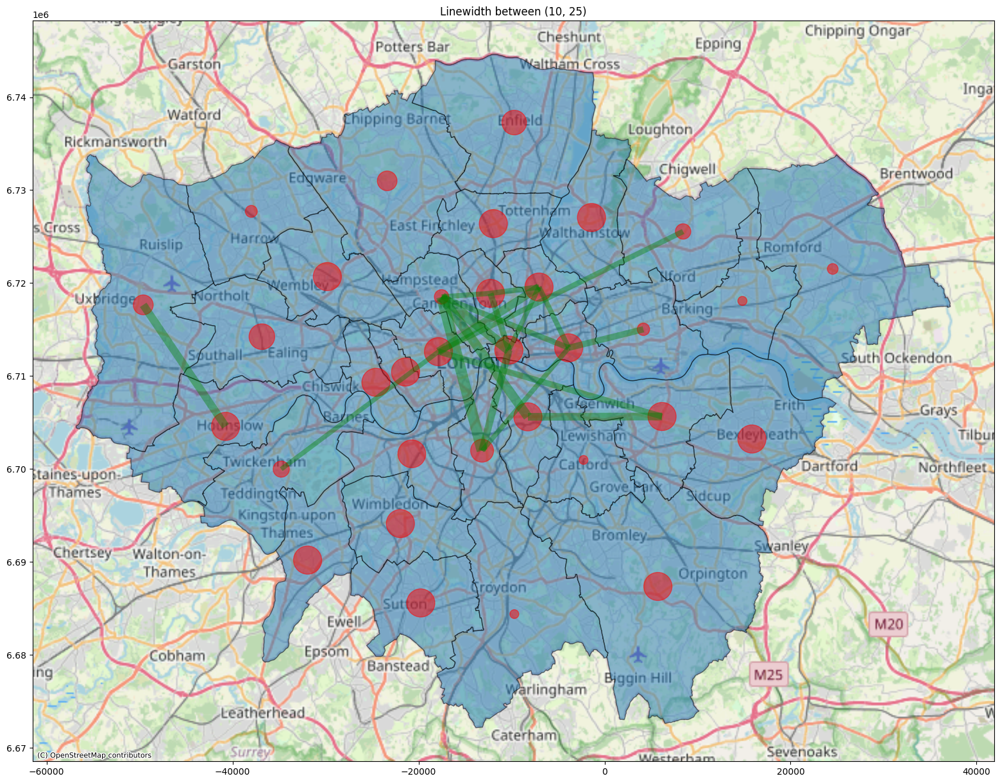

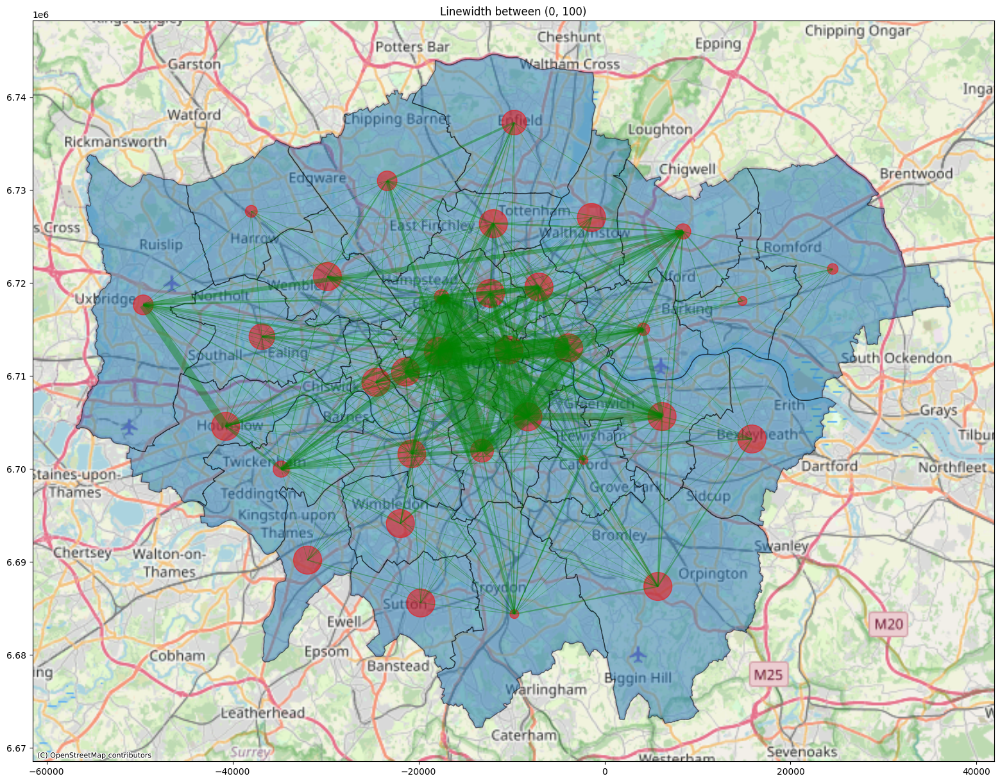

In [ ]:
gdf_od_m_['linewidth_new'] = 1 + (gdf_od_m_['linewidth'] - gdf_od_m_['linewidth'].min()) * (99) / (gdf_od_m_['linewidth'].max() - gdf_od_m_['linewidth'].min())


linewidths = [(75,100), (50,75), (25,50), (10,25), (0,100)]

for width in linewidths:
    filtered_width = gdf_od_m_[(gdf_od_m_['linewidth_new']>=width[0]) & (gdf_od_m_['linewidth_new']<=width[1])]

    fig, ax = plt.subplots(1, 1, figsize=(30, 15))
    ax = filtered_width.plot(ax=ax,alpha=0.4, color = 'green', linewidth=filtered_width['linewidth_new']/2, figsize=(16, 9))
    ax = gdf_areas_combined.to_crs(crs_web).plot(ax=ax, alpha=0.5, edgecolor='black')

    gdf_seperated['geometry'] = gdf_seperated['centroid']
    ax = gdf_seperated.to_crs(crs_web).plot(ax=ax, alpha=0.5, markersize=gdf_seperated['markersize'], color='red')

    ctx.add_basemap(ax=ax, crs=crs_web, source=map_source)
    ax.set_title('Linewidth between ' + str(width))



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
